In [6]:
import numpy as np
import pandas as pd
import os
import re
import tensorflow as tf
from tqdm import tqdm
import matplotlib.pyplot as plt
# import plotly.express as px
#from plotly.offline import init_notebook_mode
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Activation, Dropout, Flatten, Dense, Input, Layer
from tensorflow.keras.layers import BatchNormalization, Conv2DTranspose, LeakyReLU, Reshape, Activation
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from sklearn.model_selection import train_test_split
import pandas as pd
from tensorflow.keras.models import load_model
import os
from keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
!pip install tqdm
from tqdm import tqdm
from sklearn.metrics import classification_report
print("START  ")


[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
START  


2023-07-15 12:28:40.684871: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-07-15 12:28:40.706458: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-07-15 12:28:40.706572: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


Found 10000 images belonging to 1 classes.


(64, 64, 64, 3)

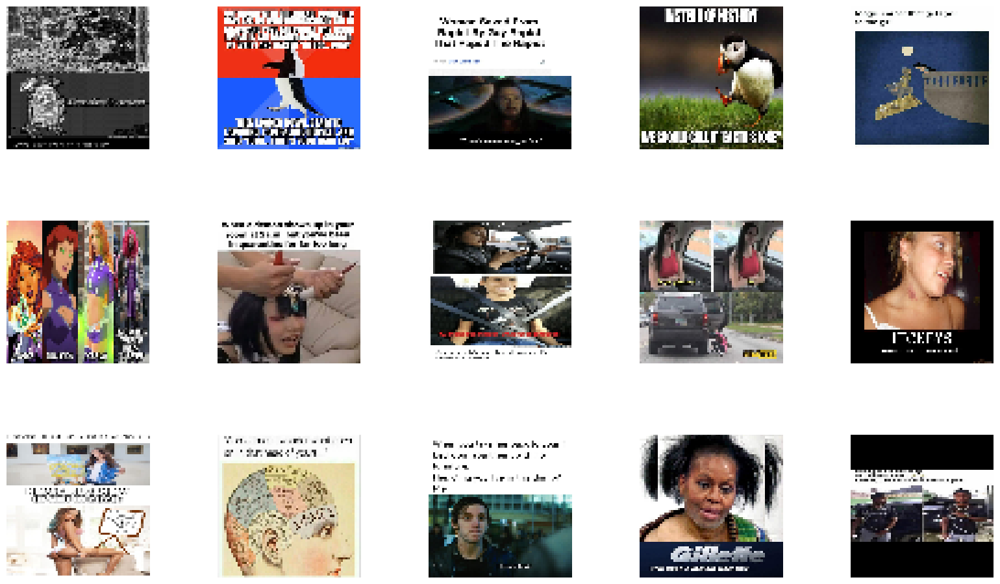

In [2]:
os.getcwd()
import tensorflow as tf
tf.config.list_physical_devices('GPU')

img_size = 64
batch_size = 64

#scale between -1 and +1
def scaling(x):
    x = (x-127.5)/127.5 
    return x
data_dir ='/home/nitesh/Documents/MY_THESIS/MAMI'
classes = ['TRAINING']
datagen = ImageDataGenerator(preprocessing_function=scaling)

data_generator = datagen.flow_from_directory(directory=data_dir,
                                        target_size=(img_size,img_size),
                                        class_mode=None,
                                        batch_size=batch_size,
                                        classes=classes,
                                        shuffle=True)

samples = data_generator.samples


images = data_generator.__next__()

plt.figure(figsize = (20 , 20))
for i in range(15):
    plt.subplot(5 , 5, i+1)
    plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
    plt.imshow((images[i]+1)/2)
    plt.axis('off')
images.shape

In [3]:
discriminator = Sequential(
    [
        Input(shape=(64, 64, 3)),
        Conv2D(32, kernel_size=5, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.2),
        Conv2D(64, kernel_size=5, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(0.2),
        Conv2D(128, kernel_size=5, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(0.2),
        Conv2D(256, kernel_size=5, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(0.2),
        Conv2D(256, kernel_size=5, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(0.2),
        Flatten(),
        Dropout(0.4),
        Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)
discriminator.summary()


latent_dim = 256

generator = Sequential(
    [
        Input(shape=(latent_dim,)),
        Dense(4 * 4 * 256),
        Reshape((4, 4, 256)),
        Conv2DTranspose(256, kernel_size=4, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.2),
        Conv2DTranspose(128, kernel_size=4, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.2),
        Conv2DTranspose(64, kernel_size=4, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.2),
        Conv2DTranspose(64, kernel_size=4, strides=2, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.2),
        Conv2D(3, kernel_size=5, padding="same", activation="tanh"),
    ],
    name="generator",
)
generator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 32)        2432      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 32)       128       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 64)        51264     
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 64)      

2023-07-15 12:28:47.284109: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-15 12:28:47.284675: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-07-15 12:28:47.284826: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-07-15 12:28:47.284901: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so ret

Epoch:  1


  0%|                                                   | 0/157 [00:00<?, ?it/s]2023-07-15 12:28:56.952703: I tensorflow/stream_executor/cuda/cuda_blas.cc:1786] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-07-15 12:28:57.043915: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8700
100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]

Epoch: 1 Generator Loss: 5.8881940841674805 Discriminator Loss: 0.27846336364746094


Epoch:  2


100%|█████████████████████████████████████████| 157/157 [00:28<00:00,  5.60it/s]

Epoch: 2 Generator Loss: 4.8799662590026855 Discriminator Loss: 0.27403539419174194


Epoch:  3


100%|█████████████████████████████████████████| 157/157 [00:28<00:00,  5.56it/s]

Epoch: 3 Generator Loss: 4.824490070343018 Discriminator Loss: 0.2560341954231262


Epoch:  4


100%|█████████████████████████████████████████| 157/157 [00:28<00:00,  5.52it/s]

Epoch: 4 Generator Loss: 4.6962456703186035 Discriminator Loss: 0.25623273849487305


Epoch:  5


100%|█████████████████████████████████████████| 157/157 [00:28<00:00,  5.44it/s]


Epoch: 5 Generator Loss: 4.535919666290283 Discriminator Loss: 0.257895290851593
Epoch:  6


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.32it/s]

Epoch: 6 Generator Loss: 4.401764392852783 Discriminator Loss: 0.2587273418903351


Epoch:  7


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]

Epoch: 7 Generator Loss: 4.2821574211120605 Discriminator Loss: 0.26099899411201477


Epoch:  8


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.38it/s]

Epoch: 8 Generator Loss: 4.16349983215332 Discriminator Loss: 0.2630934715270996


Epoch:  9


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.34it/s]

Epoch: 9 Generator Loss: 4.07413387298584 Discriminator Loss: 0.26275965571403503


Epoch:  10


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 10 Generator Loss: 4.016750335693359 Discriminator Loss: 0.26055437326431274
Epoch:  11


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 11 Generator Loss: 3.979706048965454 Discriminator Loss: 0.25759240984916687
Epoch:  12


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]

Epoch: 12 Generator Loss: 3.9539453983306885 Discriminator Loss: 0.2546398341655731


Epoch:  13


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 13 Generator Loss: 3.9218883514404297 Discriminator Loss: 0.25139090418815613
Epoch:  14


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]

Epoch: 14 Generator Loss: 3.9022464752197266 Discriminator Loss: 0.248989999294281


Epoch:  15


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 15 Generator Loss: 3.8780274391174316 Discriminator Loss: 0.24605697393417358
Epoch:  16


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 16 Generator Loss: 3.887028932571411 Discriminator Loss: 0.2419096827507019
Epoch:  17


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 17 Generator Loss: 3.8704793453216553 Discriminator Loss: 0.23993681371212006
Epoch:  18


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 18 Generator Loss: 3.841379404067993 Discriminator Loss: 0.2384064793586731
Epoch:  19


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 19 Generator Loss: 3.815927028656006 Discriminator Loss: 0.2381436973810196
Epoch:  20


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 20 Generator Loss: 3.802304983139038 Discriminator Loss: 0.2371254861354828
Epoch:  21


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


Epoch: 21 Generator Loss: 3.791628122329712 Discriminator Loss: 0.2365206927061081
Epoch:  22


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.07it/s]


Epoch: 22 Generator Loss: 3.7778947353363037 Discriminator Loss: 0.23627932369709015
Epoch:  23


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 23 Generator Loss: 3.7632768154144287 Discriminator Loss: 0.23609668016433716
Epoch:  24


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 24 Generator Loss: 3.7532575130462646 Discriminator Loss: 0.23572194576263428
Epoch:  25


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 25 Generator Loss: 3.7407450675964355 Discriminator Loss: 0.23572078347206116
Epoch:  26


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


Epoch: 26 Generator Loss: 3.732767343521118 Discriminator Loss: 0.23581740260124207
Epoch:  27


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.99it/s]


Epoch: 27 Generator Loss: 3.7289514541625977 Discriminator Loss: 0.23494812846183777
Epoch:  28


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


Epoch: 28 Generator Loss: 3.7303483486175537 Discriminator Loss: 0.23416365683078766
Epoch:  29


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 29 Generator Loss: 3.7206075191497803 Discriminator Loss: 0.23465889692306519
Epoch:  30


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


Epoch: 30 Generator Loss: 3.714280128479004 Discriminator Loss: 0.2339690774679184
Epoch:  31


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 31 Generator Loss: 3.7086784839630127 Discriminator Loss: 0.23332379758358002
Epoch:  32


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 32 Generator Loss: 3.7068381309509277 Discriminator Loss: 0.2328108251094818
Epoch:  33


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 33 Generator Loss: 3.707167625427246 Discriminator Loss: 0.23230129480361938
Epoch:  34


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 34 Generator Loss: 3.7093582153320312 Discriminator Loss: 0.23179112374782562
Epoch:  35


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


Epoch: 35 Generator Loss: 3.7118659019470215 Discriminator Loss: 0.23122920095920563
Epoch:  36


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.98it/s]


Epoch: 36 Generator Loss: 3.7148654460906982 Discriminator Loss: 0.23066315054893494
Epoch:  37


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


Epoch: 37 Generator Loss: 3.7186169624328613 Discriminator Loss: 0.23082338273525238
Epoch:  38


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.81it/s]


Epoch: 38 Generator Loss: 3.725541353225708 Discriminator Loss: 0.2297840565443039
Epoch:  39


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


Epoch: 39 Generator Loss: 3.732469320297241 Discriminator Loss: 0.22923032939434052
Epoch:  40


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


Epoch: 40 Generator Loss: 3.73878812789917 Discriminator Loss: 0.22868642210960388
Epoch:  41


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 41 Generator Loss: 3.747892141342163 Discriminator Loss: 0.22821299731731415
Epoch:  42


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


Epoch: 42 Generator Loss: 3.7579753398895264 Discriminator Loss: 0.2273373305797577
Epoch:  43


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


Epoch: 43 Generator Loss: 3.77016019821167 Discriminator Loss: 0.22654148936271667
Epoch:  44


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 44 Generator Loss: 3.780311346054077 Discriminator Loss: 0.22590303421020508
Epoch:  45


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


Epoch: 45 Generator Loss: 3.7885031700134277 Discriminator Loss: 0.22523322701454163
Epoch:  46


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


Epoch: 46 Generator Loss: 3.801264762878418 Discriminator Loss: 0.2243126481771469
Epoch:  47


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


Epoch: 47 Generator Loss: 3.8118817806243896 Discriminator Loss: 0.2237575501203537
Epoch:  48


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.98it/s]


Epoch: 48 Generator Loss: 3.823277235031128 Discriminator Loss: 0.22299781441688538
Epoch:  49


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


Epoch: 49 Generator Loss: 3.8345019817352295 Discriminator Loss: 0.22224019467830658
Epoch:  50


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


Epoch: 50 Generator Loss: 3.8475465774536133 Discriminator Loss: 0.22148337960243225
Epoch:  51


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 51 Generator Loss: 3.8583829402923584 Discriminator Loss: 0.2210051268339157
Epoch:  52


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 52 Generator Loss: 3.8714993000030518 Discriminator Loss: 0.2200530618429184
Epoch:  53


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.98it/s]


Epoch: 53 Generator Loss: 3.885019540786743 Discriminator Loss: 0.2190929651260376
Epoch:  54


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


Epoch: 54 Generator Loss: 3.8993871212005615 Discriminator Loss: 0.21837997436523438
Epoch:  55


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


Epoch: 55 Generator Loss: 3.9131202697753906 Discriminator Loss: 0.21761997044086456
Epoch:  56


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.93it/s]


Epoch: 56 Generator Loss: 3.9277729988098145 Discriminator Loss: 0.2168165147304535
Epoch:  57


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


Epoch: 57 Generator Loss: 3.941423177719116 Discriminator Loss: 0.21611912548542023
Epoch:  58


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.97it/s]


Epoch: 58 Generator Loss: 3.954643487930298 Discriminator Loss: 0.21541064977645874
Epoch:  59


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.88it/s]


Epoch: 59 Generator Loss: 3.9681756496429443 Discriminator Loss: 0.21468380093574524
Epoch:  60


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.02it/s]


Epoch: 60 Generator Loss: 3.9830074310302734 Discriminator Loss: 0.21407711505889893
Epoch:  61


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


Epoch: 61 Generator Loss: 3.999443292617798 Discriminator Loss: 0.2132807821035385
Epoch:  62


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.95it/s]


Epoch: 62 Generator Loss: 4.013689994812012 Discriminator Loss: 0.21246428787708282
Epoch:  63


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


Epoch: 63 Generator Loss: 4.027958869934082 Discriminator Loss: 0.21195970475673676
Epoch:  64


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


Epoch: 64 Generator Loss: 4.042104244232178 Discriminator Loss: 0.2111988663673401
Epoch:  65


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


Epoch: 65 Generator Loss: 4.058035373687744 Discriminator Loss: 0.21039777994155884
Epoch:  66


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.89it/s]


Epoch: 66 Generator Loss: 4.073625564575195 Discriminator Loss: 0.20975501835346222
Epoch:  67


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.97it/s]


Epoch: 67 Generator Loss: 4.089890003204346 Discriminator Loss: 0.20910067856311798
Epoch:  68


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


Epoch: 68 Generator Loss: 4.103268146514893 Discriminator Loss: 0.20837077498435974
Epoch:  69


100%|█████████████████████████████████████████| 157/157 [00:33<00:00,  4.65it/s]


Epoch: 69 Generator Loss: 4.118771076202393 Discriminator Loss: 0.20747049152851105
Epoch:  70


100%|█████████████████████████████████████████| 157/157 [00:34<00:00,  4.62it/s]


Epoch: 70 Generator Loss: 4.136083602905273 Discriminator Loss: 0.20650869607925415
Epoch:  71


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.96it/s]


Epoch: 71 Generator Loss: 4.153775215148926 Discriminator Loss: 0.20581082999706268
Epoch:  72


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.97it/s]


Epoch: 72 Generator Loss: 4.170699119567871 Discriminator Loss: 0.20505370199680328
Epoch:  73


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.85it/s]


Epoch: 73 Generator Loss: 4.190356254577637 Discriminator Loss: 0.20412017405033112
Epoch:  74


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


Epoch: 74 Generator Loss: 4.208352088928223 Discriminator Loss: 0.20353741943836212
Epoch:  75


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.95it/s]


Epoch: 75 Generator Loss: 4.225742340087891 Discriminator Loss: 0.20266097784042358
Epoch:  76


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.90it/s]


Epoch: 76 Generator Loss: 4.244366645812988 Discriminator Loss: 0.201908677816391
Epoch:  77


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.81it/s]


Epoch: 77 Generator Loss: 4.262546062469482 Discriminator Loss: 0.20100362598896027
Epoch:  78


100%|█████████████████████████████████████████| 157/157 [00:32<00:00,  4.87it/s]


Epoch: 78 Generator Loss: 4.28173303604126 Discriminator Loss: 0.20012032985687256
Epoch:  79


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.92it/s]


Epoch: 79 Generator Loss: 4.299674987792969 Discriminator Loss: 0.19939206540584564
Epoch:  80


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.00it/s]


Epoch: 80 Generator Loss: 4.318540573120117 Discriminator Loss: 0.19848063588142395
Epoch:  81


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  4.92it/s]


Epoch: 81 Generator Loss: 4.338749408721924 Discriminator Loss: 0.1976330727338791
Epoch:  82


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


Epoch: 82 Generator Loss: 4.359620094299316 Discriminator Loss: 0.1967536062002182
Epoch:  83


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.01it/s]


Epoch: 83 Generator Loss: 4.378323078155518 Discriminator Loss: 0.19600071012973785
Epoch:  84


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


Epoch: 84 Generator Loss: 4.396514415740967 Discriminator Loss: 0.19514040648937225
Epoch:  85


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 85 Generator Loss: 4.416121482849121 Discriminator Loss: 0.19426938891410828
Epoch:  86


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


Epoch: 86 Generator Loss: 4.436126232147217 Discriminator Loss: 0.19344137609004974
Epoch:  87


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 87 Generator Loss: 4.455576419830322 Discriminator Loss: 0.19265174865722656
Epoch:  88


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.05it/s]


Epoch: 88 Generator Loss: 4.475295066833496 Discriminator Loss: 0.19180376827716827
Epoch:  89


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.23it/s]


Epoch: 89 Generator Loss: 4.494344234466553 Discriminator Loss: 0.19093011319637299
Epoch:  90


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 90 Generator Loss: 4.514714241027832 Discriminator Loss: 0.19011712074279785
Epoch:  91


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 91 Generator Loss: 4.534482479095459 Discriminator Loss: 0.18929468095302582
Epoch:  92


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 92 Generator Loss: 4.553503036499023 Discriminator Loss: 0.18855002522468567
Epoch:  93


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 93 Generator Loss: 4.574563503265381 Discriminator Loss: 0.18771812319755554
Epoch:  94


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 94 Generator Loss: 4.59330940246582 Discriminator Loss: 0.18691371381282806
Epoch:  95


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


Epoch: 95 Generator Loss: 4.6131367683410645 Discriminator Loss: 0.1860431730747223
Epoch:  96


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 96 Generator Loss: 4.634375095367432 Discriminator Loss: 0.18517273664474487
Epoch:  97


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.23it/s]


Epoch: 97 Generator Loss: 4.655338764190674 Discriminator Loss: 0.1842980980873108
Epoch:  98


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.08it/s]


Epoch: 98 Generator Loss: 4.676886558532715 Discriminator Loss: 0.1834622472524643
Epoch:  99


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 99 Generator Loss: 4.698782920837402 Discriminator Loss: 0.1826435774564743
Epoch:  100


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 100 Generator Loss: 4.719311714172363 Discriminator Loss: 0.1818850040435791
Epoch:  101


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 101 Generator Loss: 4.739693641662598 Discriminator Loss: 0.18109039962291718
Epoch:  102


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


Epoch: 102 Generator Loss: 4.760458946228027 Discriminator Loss: 0.18026220798492432
Epoch:  103


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


Epoch: 103 Generator Loss: 4.782161235809326 Discriminator Loss: 0.17949378490447998
Epoch:  104


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 104 Generator Loss: 4.803744792938232 Discriminator Loss: 0.1786453127861023
Epoch:  105


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 105 Generator Loss: 4.825923442840576 Discriminator Loss: 0.17795857787132263


/tmp/ipykernel_12090/89318451.py:79: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (20 , 6))


Epoch:  106


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


Epoch: 106 Generator Loss: 4.846182346343994 Discriminator Loss: 0.17725126445293427
Epoch:  107


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.11it/s]


Epoch: 107 Generator Loss: 4.866285800933838 Discriminator Loss: 0.17655563354492188
Epoch:  108


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 108 Generator Loss: 4.886630058288574 Discriminator Loss: 0.17572586238384247
Epoch:  109


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


Epoch: 109 Generator Loss: 4.9081597328186035 Discriminator Loss: 0.17496027052402496
Epoch:  110


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 110 Generator Loss: 4.927906036376953 Discriminator Loss: 0.17435161769390106
Epoch:  111


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.04it/s]


Epoch: 111 Generator Loss: 4.947694778442383 Discriminator Loss: 0.1735670566558838
Epoch:  112


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 112 Generator Loss: 4.968545913696289 Discriminator Loss: 0.17277182638645172
Epoch:  113


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.09it/s]


Epoch: 113 Generator Loss: 4.989525318145752 Discriminator Loss: 0.17198382318019867
Epoch:  114


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 114 Generator Loss: 5.011135101318359 Discriminator Loss: 0.17123720049858093
Epoch:  115


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.33it/s]


Epoch: 115 Generator Loss: 5.032288551330566 Discriminator Loss: 0.17052628099918365
Epoch:  116


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 116 Generator Loss: 5.053133964538574 Discriminator Loss: 0.1699003130197525
Epoch:  117


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 117 Generator Loss: 5.072811126708984 Discriminator Loss: 0.16925407946109772
Epoch:  118


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 118 Generator Loss: 5.092139720916748 Discriminator Loss: 0.16857169568538666
Epoch:  119


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


Epoch: 119 Generator Loss: 5.111882209777832 Discriminator Loss: 0.1678513139486313
Epoch:  120


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.29it/s]


Epoch: 120 Generator Loss: 5.132180213928223 Discriminator Loss: 0.16713348031044006
Epoch:  121


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


Epoch: 121 Generator Loss: 5.151407718658447 Discriminator Loss: 0.16652093827724457
Epoch:  122


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 122 Generator Loss: 5.172070026397705 Discriminator Loss: 0.16585604846477509
Epoch:  123


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


Epoch: 123 Generator Loss: 5.191758632659912 Discriminator Loss: 0.16514119505882263
Epoch:  124


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.13it/s]


Epoch: 124 Generator Loss: 5.212111949920654 Discriminator Loss: 0.16445252299308777
Epoch:  125


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 125 Generator Loss: 5.232851505279541 Discriminator Loss: 0.1638493686914444
Epoch:  126


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 126 Generator Loss: 5.252898693084717 Discriminator Loss: 0.16318701207637787
Epoch:  127


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 127 Generator Loss: 5.271934509277344 Discriminator Loss: 0.1626022607088089
Epoch:  128


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 128 Generator Loss: 5.291366100311279 Discriminator Loss: 0.1619694083929062
Epoch:  129


100%|█████████████████████████████████████████| 157/157 [00:31<00:00,  5.06it/s]


Epoch: 129 Generator Loss: 5.310307502746582 Discriminator Loss: 0.16130459308624268
Epoch:  130


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.10it/s]


Epoch: 130 Generator Loss: 5.330725193023682 Discriminator Loss: 0.1606982946395874
Epoch:  131


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 131 Generator Loss: 5.349325656890869 Discriminator Loss: 0.16012373566627502
Epoch:  132


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.28it/s]


Epoch: 132 Generator Loss: 5.367673397064209 Discriminator Loss: 0.1595052182674408
Epoch:  133


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 133 Generator Loss: 5.387361526489258 Discriminator Loss: 0.1589590311050415
Epoch:  134


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


Epoch: 134 Generator Loss: 5.405516147613525 Discriminator Loss: 0.15837925672531128
Epoch:  135


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


Epoch: 135 Generator Loss: 5.423830986022949 Discriminator Loss: 0.15780985355377197
Epoch:  136


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 136 Generator Loss: 5.44149112701416 Discriminator Loss: 0.15729913115501404
Epoch:  137


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


Epoch: 137 Generator Loss: 5.459885120391846 Discriminator Loss: 0.15666033327579498
Epoch:  138


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.25it/s]


Epoch: 138 Generator Loss: 5.477755546569824 Discriminator Loss: 0.15610645711421967
Epoch:  139


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 139 Generator Loss: 5.496310710906982 Discriminator Loss: 0.15554724633693695
Epoch:  140


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 140 Generator Loss: 5.513963222503662 Discriminator Loss: 0.15501898527145386
Epoch:  141


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 141 Generator Loss: 5.531644344329834 Discriminator Loss: 0.15444721281528473
Epoch:  142


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 142 Generator Loss: 5.549929141998291 Discriminator Loss: 0.15386630594730377
Epoch:  143


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


Epoch: 143 Generator Loss: 5.568962097167969 Discriminator Loss: 0.1533472090959549
Epoch:  144


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


Epoch: 144 Generator Loss: 5.58597469329834 Discriminator Loss: 0.1528625786304474
Epoch:  145


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 145 Generator Loss: 5.603359222412109 Discriminator Loss: 0.15235011279582977
Epoch:  146


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 146 Generator Loss: 5.620734691619873 Discriminator Loss: 0.15182164311408997
Epoch:  147


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 147 Generator Loss: 5.637691974639893 Discriminator Loss: 0.15131232142448425
Epoch:  148


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 148 Generator Loss: 5.653658390045166 Discriminator Loss: 0.1508176624774933
Epoch:  149


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 149 Generator Loss: 5.670252799987793 Discriminator Loss: 0.15029339492321014
Epoch:  150


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 150 Generator Loss: 5.68718147277832 Discriminator Loss: 0.14975814521312714
Epoch:  151


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


Epoch: 151 Generator Loss: 5.703794479370117 Discriminator Loss: 0.14919114112854004
Epoch:  152


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


Epoch: 152 Generator Loss: 5.720602989196777 Discriminator Loss: 0.14871405065059662
Epoch:  153


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


Epoch: 153 Generator Loss: 5.735769748687744 Discriminator Loss: 0.14824934303760529
Epoch:  154


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.14it/s]


Epoch: 154 Generator Loss: 5.751978397369385 Discriminator Loss: 0.14768658578395844
Epoch:  155


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 155 Generator Loss: 5.768798351287842 Discriminator Loss: 0.14718805253505707
Epoch:  156


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 156 Generator Loss: 5.785031318664551 Discriminator Loss: 0.14664024114608765
Epoch:  157


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 157 Generator Loss: 5.801409721374512 Discriminator Loss: 0.1461334377527237
Epoch:  158


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 158 Generator Loss: 5.817623615264893 Discriminator Loss: 0.1455800086259842
Epoch:  159


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


Epoch: 159 Generator Loss: 5.834611892700195 Discriminator Loss: 0.14508868753910065
Epoch:  160


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.17it/s]


Epoch: 160 Generator Loss: 5.850709915161133 Discriminator Loss: 0.1446240246295929
Epoch:  161


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 161 Generator Loss: 5.866784572601318 Discriminator Loss: 0.1441335678100586
Epoch:  162


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 162 Generator Loss: 5.88268518447876 Discriminator Loss: 0.14363110065460205
Epoch:  163


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 163 Generator Loss: 5.899641036987305 Discriminator Loss: 0.14314712584018707
Epoch:  164


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.16it/s]


Epoch: 164 Generator Loss: 5.915467739105225 Discriminator Loss: 0.1426309049129486
Epoch:  165


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.21it/s]


Epoch: 165 Generator Loss: 5.93153190612793 Discriminator Loss: 0.14212171733379364
Epoch:  166


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 166 Generator Loss: 5.948348045349121 Discriminator Loss: 0.14161792397499084
Epoch:  167


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.31it/s]


Epoch: 167 Generator Loss: 5.96458625793457 Discriminator Loss: 0.14112159609794617
Epoch:  168


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.20it/s]


Epoch: 168 Generator Loss: 5.980468273162842 Discriminator Loss: 0.14068159461021423
Epoch:  169


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 169 Generator Loss: 5.996436595916748 Discriminator Loss: 0.14019623398780823
Epoch:  170


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


Epoch: 170 Generator Loss: 6.012866497039795 Discriminator Loss: 0.13971157371997833
Epoch:  171


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 171 Generator Loss: 6.028783321380615 Discriminator Loss: 0.13924388587474823
Epoch:  172


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 172 Generator Loss: 6.044247627258301 Discriminator Loss: 0.13882383704185486
Epoch:  173


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.23it/s]


Epoch: 173 Generator Loss: 6.059829235076904 Discriminator Loss: 0.1383393257856369
Epoch:  174


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.15it/s]


Epoch: 174 Generator Loss: 6.075860500335693 Discriminator Loss: 0.13783904910087585
Epoch:  175


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.12it/s]


Epoch: 175 Generator Loss: 6.090877532958984 Discriminator Loss: 0.1388777643442154
Epoch:  176


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.27it/s]


Epoch: 176 Generator Loss: 6.088199138641357 Discriminator Loss: 0.13892240822315216
Epoch:  177


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.28it/s]


Epoch: 177 Generator Loss: 6.0930352210998535 Discriminator Loss: 0.13850466907024384
Epoch:  178


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.26it/s]


Epoch: 178 Generator Loss: 6.101208209991455 Discriminator Loss: 0.13798654079437256
Epoch:  179


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.22it/s]


Epoch: 179 Generator Loss: 6.11152458190918 Discriminator Loss: 0.13743001222610474
Epoch:  180


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.18it/s]


Epoch: 180 Generator Loss: 6.1243462562561035 Discriminator Loss: 0.1368936151266098
Epoch:  181


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.24it/s]


Epoch: 181 Generator Loss: 6.138326168060303 Discriminator Loss: 0.13635970652103424
Epoch:  182


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 182 Generator Loss: 6.152839660644531 Discriminator Loss: 0.13584649562835693
Epoch:  183


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.30it/s]


Epoch: 183 Generator Loss: 6.168381214141846 Discriminator Loss: 0.13532313704490662
Epoch:  184


100%|█████████████████████████████████████████| 157/157 [00:30<00:00,  5.19it/s]


Epoch: 184 Generator Loss: 6.183658123016357 Discriminator Loss: 0.13485659658908844
Epoch:  185


100%|█████████████████████████████████████████| 157/157 [00:29<00:00,  5.28it/s]


Epoch: 185 Generator Loss: 6.198588848114014 Discriminator Loss: 0.13438250124454498


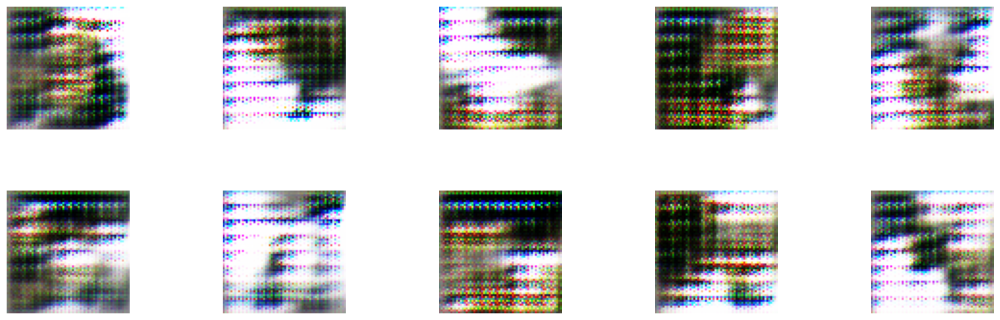

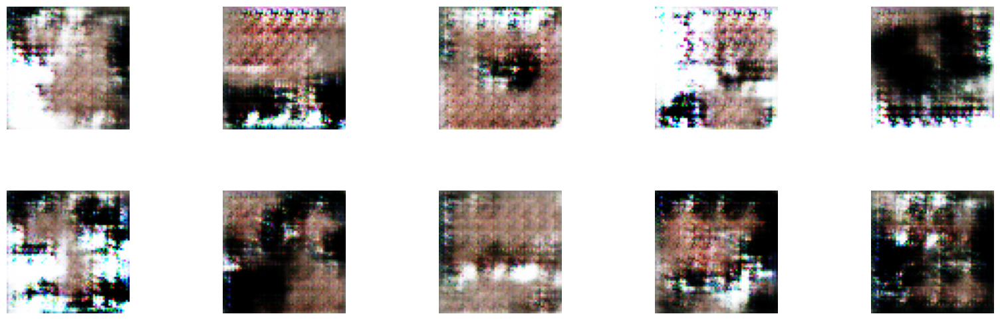

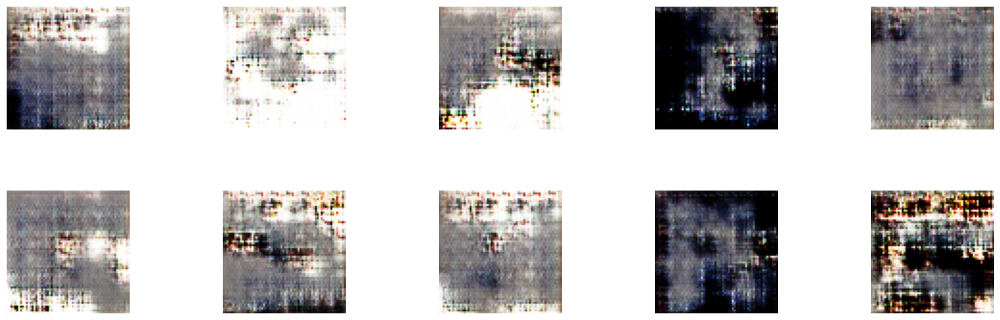

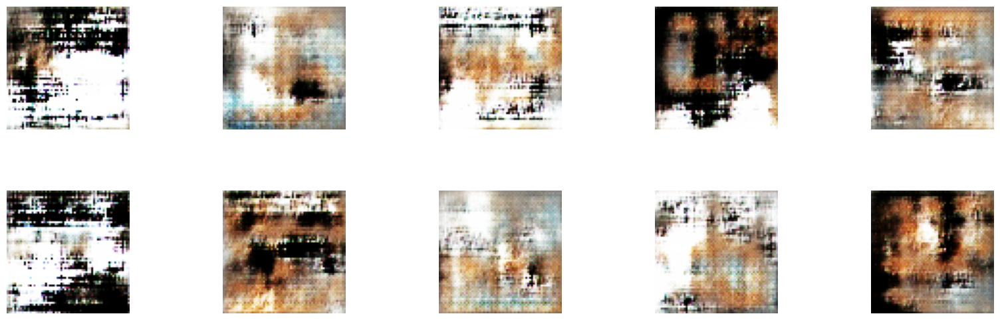

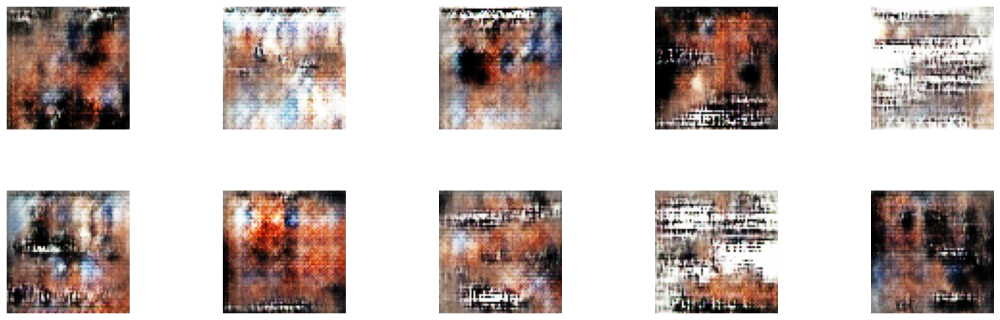

...

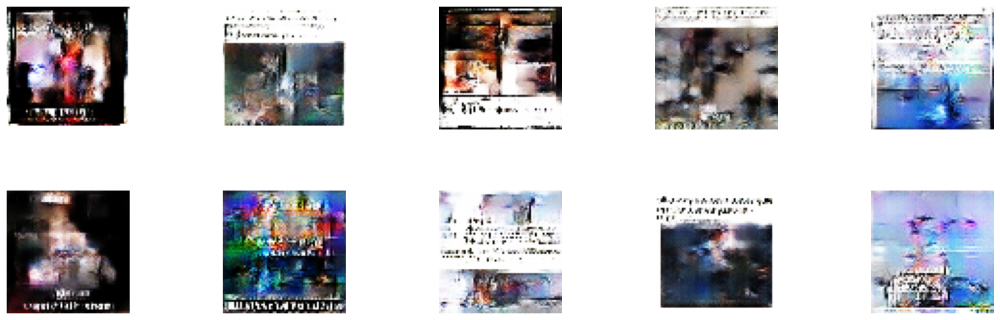

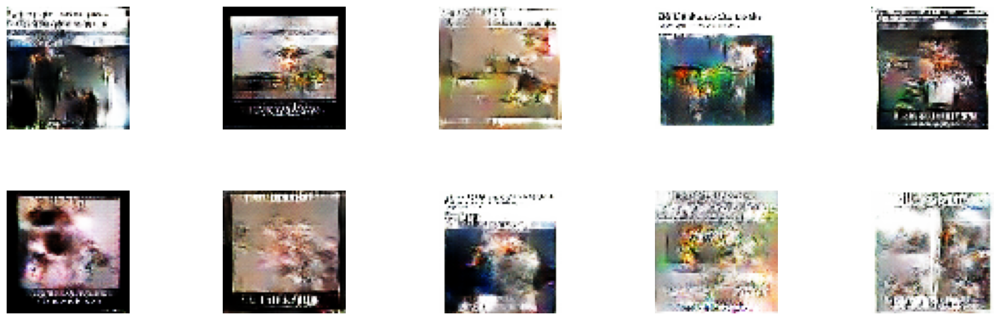

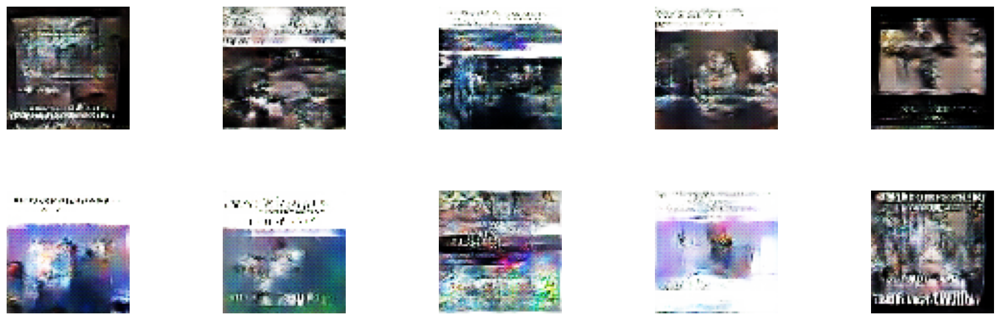

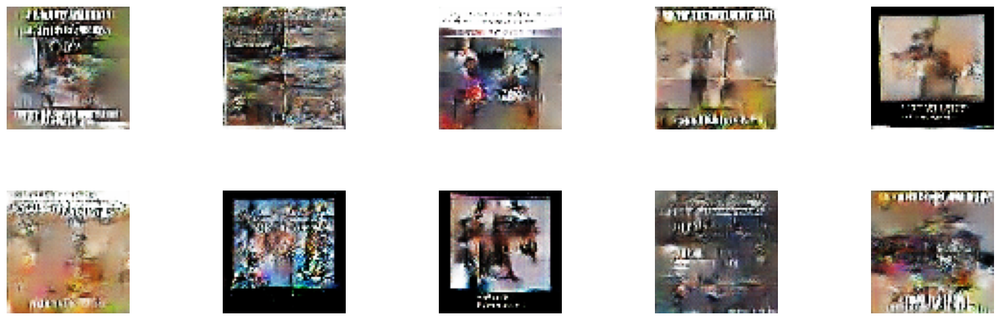

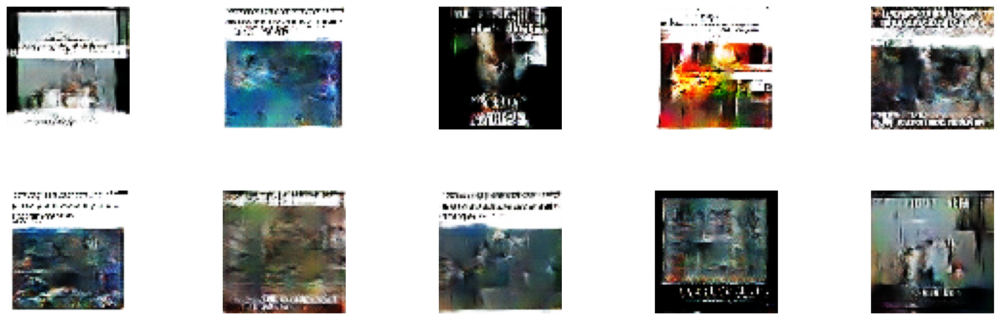

In [4]:
# Model_GAN_64_RESULTS

# Specify the directory path
results_dir = "MODEL_GAN_64_RESULTS"
os.makedirs(results_dir, exist_ok=True)

def load_models(epoch):
    print(f"Loading Mis_Generator_{epoch}.h5")
    
    # Construct the file paths
    generator_path = os.path.join(results_dir, f"Meme_Generator_{epoch}.h5")
    discriminator_path = os.path.join(results_dir, f"Meme_Discriminator_{epoch}.h5")
    
    # Load the models
    generator = load_model(generator_path)
    discriminator = load_model(discriminator_path)
    
    return generator, discriminator


gen_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
dis_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
loss_fn = tf.keras.losses.BinaryCrossentropy()
steps_per_epoch = int(-(samples/-batch_size))
discriminator_losses = []
generator_losses = []

disc_losses = []
gen_losses = []

start_epochs=1
end_epochs=185

# generator, discriminator = load_models((start_epochs-1))


#Dont Train and load start_epochs 184
#############################################################################
for epoch in range(start_epochs, end_epochs+1):
    print("Epoch: ",epoch)
    
    for idx, (real) in enumerate(tqdm(data_generator)):
        if idx > steps_per_epoch:
            break
        
        batch_size = real.shape[0]
        random_latent_vectors = tf.random.normal(shape = (batch_size, latent_dim))
        fake = generator(random_latent_vectors)

        with tf.GradientTape() as d_tape:
            loss_disc_real = loss_fn(tf.ones((batch_size, 1)), discriminator(real))
            loss_disc_fake = loss_fn(tf.zeros((batch_size, 1)), discriminator(fake))
            loss_disc = (loss_disc_real + loss_disc_fake)/2
            disc_losses.append(loss_disc)

        grads = d_tape.gradient(loss_disc, discriminator.trainable_weights)
        dis_optimizer.apply_gradients(zip(grads, discriminator.trainable_weights))

        with tf.GradientTape() as g_tape:
            fake = generator(random_latent_vectors)
            output = discriminator(fake)
            loss_gen = loss_fn(tf.ones(batch_size, 1), output)
            gen_losses.append(loss_gen)

        grads = g_tape.gradient(loss_gen, generator.trainable_weights)
        gen_optimizer.apply_gradients(zip(grads, generator.trainable_weights))
    
    mean_disc_loss = sum(disc_losses)/len(disc_losses)
    mean_gen_loss = sum(gen_losses)/len(gen_losses)
    
    print(f"Epoch: {epoch} Generator Loss: {mean_gen_loss} Discriminator Loss: {mean_disc_loss}")
    data_generator.on_epoch_end()
    discriminator_losses.append(mean_disc_loss)
    generator_losses.append(mean_gen_loss)
    if epoch % 5 == 0:
        random_latent_vectors = tf.random.normal(shape = (10, latent_dim))
        fake = generator(random_latent_vectors)
        generated_images = fake.numpy()
        plt.figure(figsize = (20 , 6))
        for i in range(10):
            plt.subplot(2 , 5, i+1)
            plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
            image = generated_images[i]
            plt.imshow((image+1)/2)
            plt.axis('off')
            save_img_path = os.path.join(results_dir, f'Meme_generated_images_epoch_{epoch}.png')
            plt.savefig(save_img_path)  # Save the plot
#         plt.show()
    generator_mdl_path = os.path.join(results_dir, f"Meme_Generator_{epoch}.h5")
    discriminator_mdl_path = os.path.join(results_dir, f"Meme_Discriminator_{epoch}.h5")
    generator.save(generator_mdl_path)
    discriminator.save(discriminator_mdl_path)

In [ ]:
# plt.figure(figsize = (20 , 20))
# for i in range(10):
#     plt.subplot(6 , 5, i+1)
#     plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
#     plt.imshow((fake[i]+1)/2)
#     plt.title(f"Index: {i}")
#     plt.axis('off')
# plt.savefig(f'8_Final_Sample_images_after_{epoch}.png')

In [5]:
import os
import natsort
from PIL import UnidentifiedImageError
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import pandas as pd
import natsort


TEST_directory = 'TEST'   # directory where we have images 
test_filenames = natsort.natsorted(os.listdir(TEST_directory))  

# Load the discriminator model
discriminator = load_model("MODEL_GAN_64_RESULTS/Meme_Discriminator_185.h5")

# Compile the discriminator model
discriminator.compile(optimizer='adam', loss='binary_crossentropy')

predicted_labels = [] 
for image_filename in test_filenames:
    image_path = os.path.join(TEST_directory, image_filename)
    
    try:
        # Load and preprocess the image
        image = load_img(image_path, target_size=(64, 64))
        image = img_to_array(image)
        image = (image - 127.5) / 127.5  # Scale between -1 and +1

        # Classify the image
        
        classification = discriminator.predict(image[np.newaxis, ...])
        is_misogynous = classification[0, 0] >= 0.5  # Threshold for classification
        
        predicted_labels.append(is_misogynous)
        print(f"Is the image {image_filename} misogynous?", is_misogynous)
    except UnidentifiedImageError:
        print(f"Skipping image {image_filename} - Unable to identify the image.")


1/1 [==============================] - 0s 134ms/step
Is the image 15001.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15002.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15004.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15005.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15006.jpg misogynous? False
1/1 [==============================] - 0s 10ms/step
Is the image 15008.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15009.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15010.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15011.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15012.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 1501

1/1 [==============================] - 0s 11ms/step
Is the image 15130.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15132.jpg misogynous? True
1/1 [==============================] - 0s 11ms/step
Is the image 15133.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15135.jpg misogynous? False
1/1 [==============================] - 0s 13ms/step
Is the image 15136.jpg misogynous? True
1/1 [==============================] - 0s 14ms/step
Is the image 15137.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15138.jpg misogynous? True
1/1 [==============================] - 0s 12ms/step
Is the image 15142.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15143.jpg misogynous? False
1/1 [==============================] - 0s 13ms/step
Is the image 15144.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15145.jp

1/1 [==============================] - 0s 12ms/step
Is the image 15433.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15435.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15436.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15437.jpg misogynous? False
1/1 [==============================] - 0s 13ms/step
Is the image 15438.jpg misogynous? True
1/1 [==============================] - 0s 11ms/step
Is the image 15442.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15444.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15446.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15448.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15449.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15450.

1/1 [==============================] - 0s 11ms/step
Is the image 15670.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15671.jpg misogynous? False
1/1 [==============================] - 0s 13ms/step
Is the image 15674.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15675.jpg misogynous? False
1/1 [==============================] - 0s 16ms/step
Is the image 15676.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15677.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15678.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15679.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15680.jpg misogynous? True
1/1 [==============================] - 0s 12ms/step
Is the image 15682.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15683.

1/1 [==============================] - 0s 11ms/step
Is the image 15902.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15903.jpg misogynous? True
1/1 [==============================] - 0s 12ms/step
Is the image 15904.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15905.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15906.jpg misogynous? True
1/1 [==============================] - 0s 12ms/step
Is the image 15907.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15908.jpg misogynous? False
1/1 [==============================] - 0s 14ms/step
Is the image 15909.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15910.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 15911.jpg misogynous? False
1/1 [==============================] - 0s 12ms/step
Is the image 15913.j

1/1 [==============================] - 0s 12ms/step
Is the image 16134.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 16136.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 16137.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 16138.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 16142.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 16143.jpg misogynous? True
1/1 [==============================] - 0s 12ms/step
Is the image 16144.jpg misogynous? False
1/1 [==============================] - 0s 10ms/step
Is the image 16145.jpg misogynous? True
1/1 [==============================] - 0s 11ms/step
Is the image 16146.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 16147.jpg misogynous? True
1/1 [==============================] - 0s 11ms/step
Is the image 16148.jp

1/1 [==============================] - 0s 12ms/step
Is the image 17046.jpg misogynous? False
1/1 [==============================] - 0s 13ms/step
Is the image 17047.jpg misogynous? False
1/1 [==============================] - 0s 13ms/step
Is the image 17048.jpg misogynous? False
1/1 [==============================] - 0s 10ms/step
Is the image 17049.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 17050.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 17051.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 17052.jpg misogynous? True
1/1 [==============================] - 0s 11ms/step
Is the image 17054.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 17055.jpg misogynous? False
1/1 [==============================] - 0s 11ms/step
Is the image 17056.jpg misogynous? True
1/1 [==============================] - 0s 12ms/step
Is the image 17058.j

In [11]:
tst_filename = test_filenames[:-1]

# Create a DataFrame from the lists
data = {'predicted_labels': predicted_labels, 
        'file_name': tst_filename}

df = pd.DataFrame(data)

# Load the Test data for testing the model 
# train = pd.read_csv('training.csv', delimiter='\t')
test1 = pd.read_csv('Test.csv', delimiter='\t')
test_labels = pd.read_csv('test_labels.txt', 
                          delimiter='\t',
                         header=None)

test_labels.columns = ['file_name', 
                      "misogynous",
                       "shaming",
                       "stereotype",
                       "objectification",
                       "violence"]

test = pd.merge(test1, test_labels, on='file_name', how='inner')
test = test.rename(columns={'Text Transcription': 'text'})


# Assuming you have a DataFrame called df with a column 'filename'
# Sort the DataFrame based on the 'filename' column numerically
test_sorted = test.sort_values('file_name', 
                               key=lambda x: natsort.natsort_keygen()(x))

# Print the sorted DataFrame
test_sorted

# Assuming you have a DataFrame called test_sorted and df
# Inner join on the 'file_name' column
merged_df = pd.merge(test_sorted, df, on='file_name', how='inner')

# Print the merged DataFrame
# merged_df

from sklearn.metrics import confusion_matrix

# Extract the actual and predicted labels
actual_labels = merged_df["misogynous"]
predicted_labels = merged_df["predicted_labels"]

class_labels = [0,1]
class_labels1 = ['non_misogyn', 'misogyn']
confusion_mat = confusion_matrix(actual_labels, predicted_labels, labels=class_labels)
print("Confusion Matrix:")
# print(confusion_mat)
confusion_df = pd.DataFrame(confusion_mat, index=class_labels1, columns=class_labels1)
print(confusion_df)
print()
print()


print("Test Data Classification Report:")
classification_rep_test = classification_report(actual_labels, predicted_labels, digits=3)
print(classification_rep_test)




############################

PERFORMANCE_RESULTS = pd.DataFrame(columns=['Model', 'EvalSet', 'Accuracy', 
                       'M-Precision', 'M-Recall', 
                       'M-F1-Score', 'W-Precision',
                       'W-Recall', 'W-F1-Score'])


def export_classification_report(report, mod, eval_set=None):
    lines = report.split('\n')
    data = lines[2:4] + lines[5:9]
    data = [line.split() for line in data]
    
    acc = float(data[2][1])
    m_prec = float(data[3][2])
    m_recall = float(data[3][3])
    m_f1 = float(data[3][4])
    w_prec = float(data[4][2])
    w_recall = float(data[4][3])
    w_f1 = float(data[4][4])
    
    df = pd.DataFrame({
        'Model': [mod],
        'EvalSet': [eval_set],
        'Accuracy': [acc],
        'M-Precision': [m_prec],
        'M-Recall': [m_recall],
        'M-F1-Score': [m_f1],
        'W-Precision': [w_prec],
        'W-Recall': [w_recall],
        'W-F1-Score': [w_f1],
    }) 
    
    return df

modname  = 'GAN'
results_test= export_classification_report(classification_rep_test, modname, eval_set='test')

PERFORMANCE_RESULTS = pd.concat([PERFORMANCE_RESULTS, results_test])

display(PERFORMANCE_RESULTS)

# from sklearn.metrics import precision_score, accuracy_score, recall_score, f1_score

# # Calculate precision
# precision = precision_score(actual_labels, predicted_labels)

# # Calculate accuracy
# accuracy = accuracy_score(actual_labels, predicted_labels)

# # Calculate recall
# recall = recall_score(actual_labels, predicted_labels)

# # Calculate F1 score
# f1 = f1_score(actual_labels, predicted_labels)

# Print the metrics
# print("Precision:", precision)
# print("Accuracy:", accuracy)
# print("Recall:", recall)
# print("F1 Score:", f1)


Confusion Matrix:
             non_misogyn  misogyn
non_misogyn          400      100
misogyn              411       89


Test Data Classification Report:
              precision    recall  f1-score   support

           0      0.493     0.800     0.610       500
           1      0.471     0.178     0.258       500

    accuracy                          0.489      1000
   macro avg      0.482     0.489     0.434      1000
weighted avg      0.482     0.489     0.434      1000



,Model,EvalSet,Accuracy,M-Precision,M-Recall,M-F1-Score,W-Precision,W-Recall,W-F1-Score
0,GAN,test,0.489,0.482,0.489,0.434,0.482,0.489,0.434


In [13]:
PERFORMANCE_RESULTS.to_excel('../MAMI/8_classification_report_GAN.xlsx', 
                      index=False)

In [ ]:
# # PREDICT ON TEST DATA: 

# from tensorflow.keras.models import load_model
# from tensorflow.keras.preprocessing.image import load_img, img_to_array

# # Load the discriminator model
# discriminator = load_model("MODEL_GAN_64_RESULTS/Meme_Discriminator_185.h5")

# # Compile the discriminator model
# discriminator.compile(optimizer='adam', loss='binary_crossentropy')

# image_path = "TEST/16308.jpg"  # Replace with the actual path to your image
# image = load_img(image_path, target_size=(64, 64))
# image = img_to_array(image)
# image = (image - 127.5) / 127.5  # Scale between -1 and +1


# # Classify the image
# classification = discriminator.predict(image[np.newaxis, ...])
# is_misogynous = classification[0, 0] >= 0.5  # Threshold for classification

# print("Is the image misogynous?", is_misogynous)

In [ ]:
# 15538  # 15712  # 15318  # 15202  # 15714  # 16308

# References:

https://www.kaggle.com/code/quadeer15sh/introduction-to-dc-gans-face-generation/notebook